### О задании

Для начала импортируем все необходимые библиотеки:

In [ ]:
# Понадобится для чтения и записи аудио файлов
from scipy.io import wavfile

# Это нужно для проигрывания аудио файлов прямо в блокноте
from IPython.display import Audio

# А это стандартный набор библиотек анализа данных, необходимый для этого задания
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

Скачаем данные:

In [ ]:
! wget https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav

--2025-03-18 21:11:47--  https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.18, 2620:100:6022:18::a27d:4212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://www.dropbox.com/scl/fi/e1k6iw70j8jv1501ay5ma/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav?rlkey=zma2ojqmianoa4ry02bhxse7e [following]
--2025-03-18 21:11:48--  https://www.dropbox.com/scl/fi/e1k6iw70j8jv1501ay5ma/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav?rlkey=zma2ojqmianoa4ry02bhxse7e
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucd03d127a0ffcc06faad610599b.dl.dropboxusercontent.com/cd/0/inline/CmKKYmlUDl-KULdM9WivVFhapfnOQ68ZM1EUOkCBEBD6Wh9uySaRgCiFVgUON0WMDkqv4bAKTpD4AQ0ZSp_k0obhdEcvf8lhGXvi6LWrOJ0oStqfLl7xihnXRyc5YGZTPBa

Прочитаем аудиодорожку при помощи wavfile:


In [ ]:
samplerate, data = wavfile.read('Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav')

В ячейке выше мы с вами видим некую `samplerate`. Данная переменная по умолчанию хранит частоту дискретизации; стандартное для аудио значние — 44100 Гц.

Для тех, кто не очень хорошо знаком со способами кодирования и записи звука (aka тех, кто не сдавал в школе ЕГЭ по информатике :) ), — частота дискретизации показывает, сколько последовательных элементов массива с сигналом кодируют звук длительностью 1 секунда.

Подробнее с кодированием звука можно разобраться [тут](https://ru.wikipedia.org/wiki/Кодирование_звуковой_информации).

Итак, посмотрим, какая же частота дискретизации у нашей аудиодорожки.

In [ ]:
samplerate

44100

Если поделить длину массива сигнала на `samplerate`, получится длительность аудиодорожки в секундах. По крайней мере — должна получиться!


In [ ]:
len(data) / samplerate

45.139591836734695

Сорок пять секунд с небольшим. Похоже на правду? Сравните с длиной дорожки, запустив её у себя на компьютере.

Заметим также, что звук — стерео, так как сигнал кодируется двумя каналами (для левого и правого динамика).


In [ ]:
data.shape

(1990656, 2)

Отрисуем сигналы в обоих каналах:

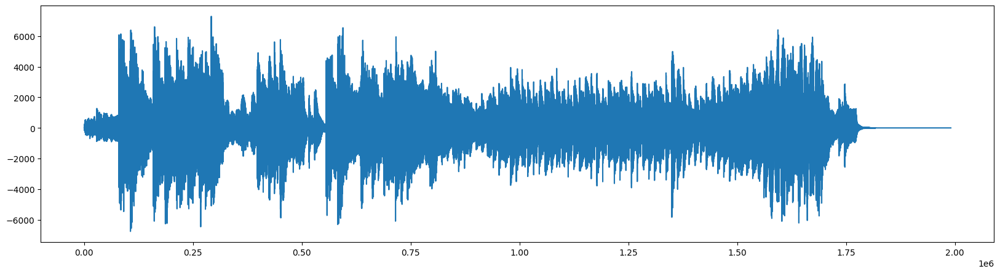

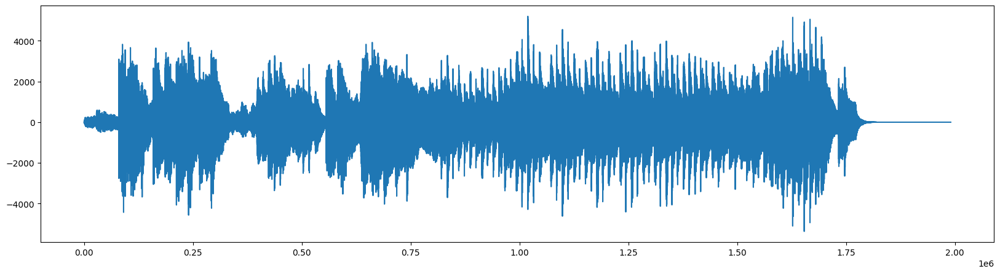

In [ ]:
# Канал 1
plt.figure(figsize=(20,5))
plt.plot(data[:,0])
plt.show()

# Канал 2
plt.figure(figsize=(20,5))
plt.plot(data[:,1])
plt.show()

Вот она — легендарная «кардиограмма» звука, с которой мы все хорошо знакомы! :)

Итак, давайте теперь усредним каналы и получим монозвук, с которым будет существенно проще работать.


In [ ]:
mono_sound = np.mean(data, axis=1)
mono_sound.shape

(1990656,)

In [ ]:
Audio(mono_sound, rate = samplerate)

Для удобства мы также обрежем массив с сигналом таким образом, чтобы его проще было делить на равные части, датасет из которых и необходимо будет сжать известными вам методами.

На самом деле, способ очень похож на тот, которым мы сжимали картинку на семинаре, разбивая её на прямоугольные подкартинки — только здесь задача по большому счету еще проще :)

In [ ]:
mono_sound_to_cut = mono_sound[:1990000]

Проверим, что наш звук теперь — это просто вектор чисел:

In [ ]:
mono_sound_to_cut.shape

(1990000,)

Замечательно, всё абсолютно готово!

Ну что же, на этом наша миссия — всё; теперь — ваш выход! :)

### Задание 1


#### 1.1. (2 балла)
Напишите функцию, которая будет разделять сигнал на равные части длиной 1000 и собирать из них "датасет", представляющий собой двумерный массив — матрицу объектов-признаков (каждая часть сигнала длины 1000 находится в отдельной строке).

In [ ]:
import pandas as pd

In [ ]:
def cut_to_piece(data):
  return data.reshape(int(data.shape[-1] / 1000), 1000)

In [ ]:
twodim_sound = cut_to_piece(mono_sound_to_cut)
twodim_sound.shape

(1990, 1000)

#### 1.2. (3 балла)

Напишите функцию, которая будет переводить вашу "матрицу" обратно в звуковой сигнал. Иными словами функция разворачивает данные из матрицы размера `(число объектов, 1000)` в вектор длины `(число объектов * 1000)`.

Запустите функцию и проверьте, что все работает корректно, путем воспроизведения "востановленного" сигнала в ноутбуке — этот сигнал должен в точности совпасть с изначальным (ведь, на самом деле, им и является).

In [ ]:
def back_to_arr(data):
  return data.reshape(data.shape[0] * 1000,)

In [ ]:
arr_sound = back_to_arr(twodim_sound)
arr_sound.shape

(1990000,)

In [ ]:
np.allclose(mono_sound_to_cut, arr_sound)

True

### Задание 2





#### 2.1. (3 балла)

Выполните PCA-преобразование нашей матрицы и получите данные, сжатые в пространство меньшей размерности.

_Подсказка. На этом этапе у нас есть наш "датасет" с 1000 "признаками" и мы хотим уменьшить число "признаков" путем применения метода PCA. Число компонент предлагается выбрать вам, но для начала не стоит брать слишком маленькое число, чтобы потом было проще понять, в случае плохого результата: это компонент оказалось недостаточно или же это вы где-то ошиблись :)_

    

In [ ]:
pca = PCA(n_components=30)
Y = pca.fit_transform(twodim_sound)

#### 2.2. (4 балла)

Визуализируйте наши "объекты" в наглядной форме на плоскости. Сделайте выводы исходя из их вида.

_Подсказка. Для этого вам необходимо применить PCA некоторым специальным образом, который мы в том числе обсуждали на семинаре._

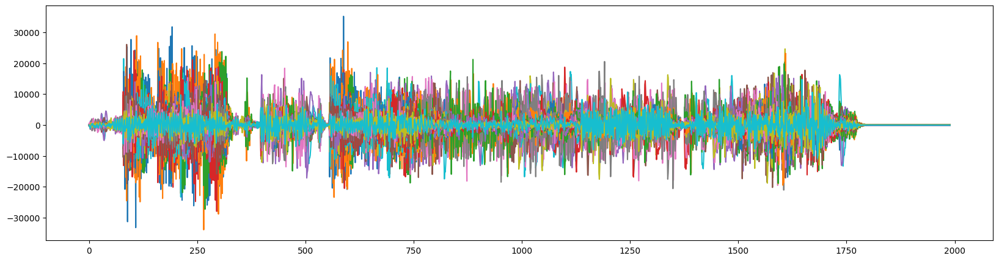

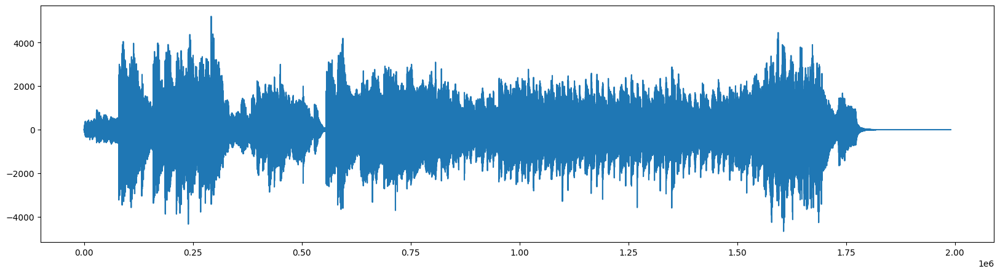

In [ ]:
plt.figure(figsize=(20,5))
plt.plot(Y)
plt.show()

plt.figure(figsize=(20,5))
plt.plot(mono_sound)
plt.show()

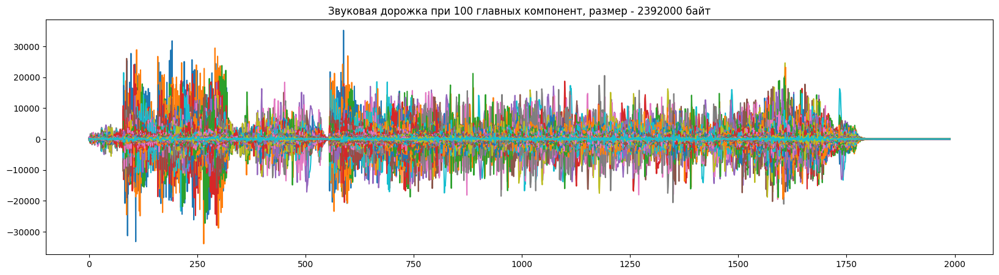

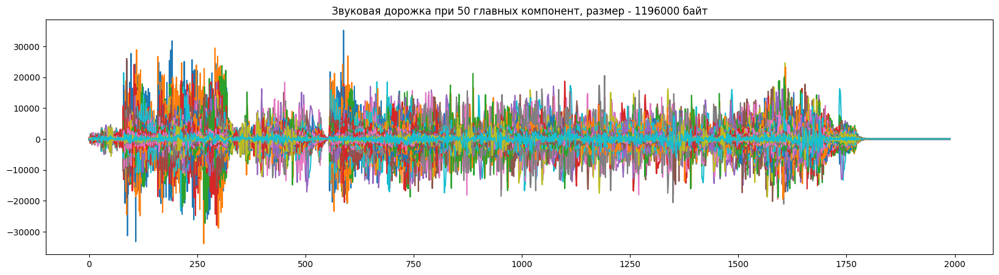

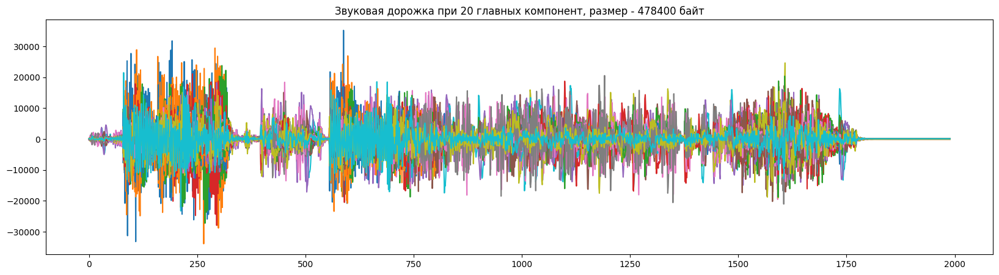

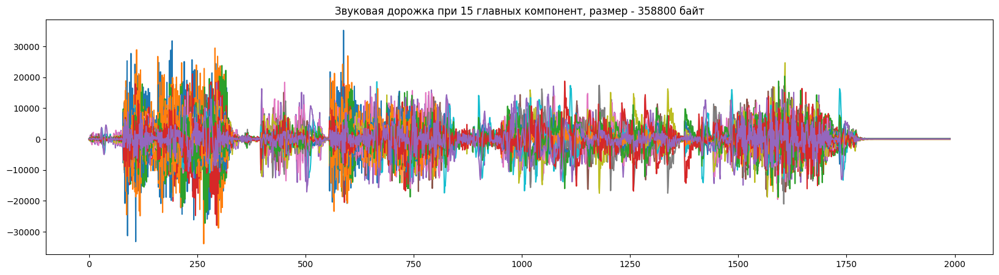

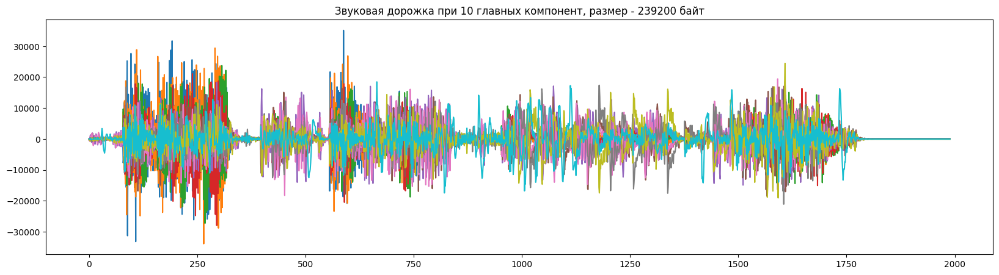

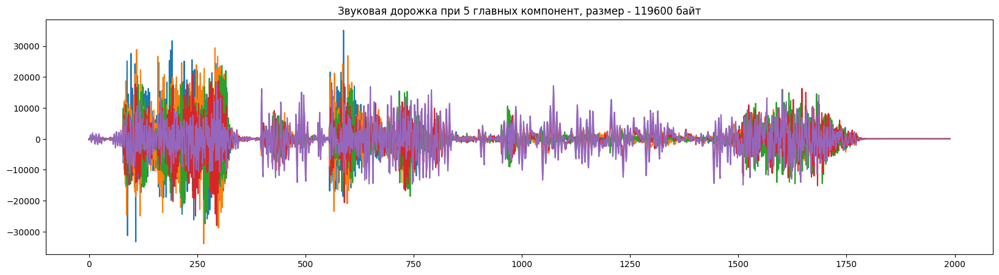

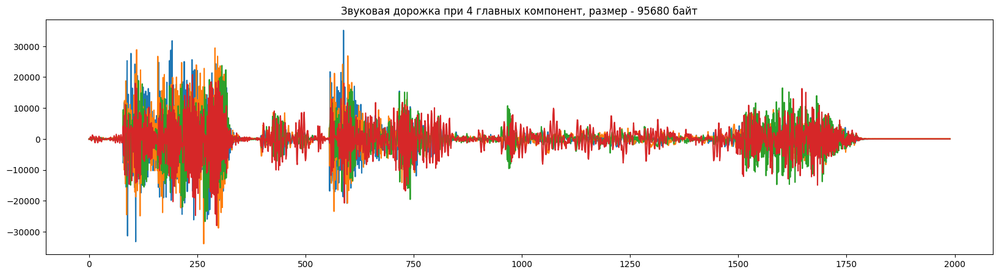

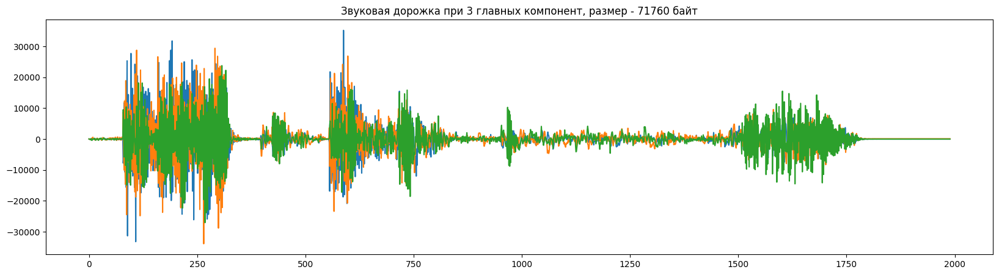

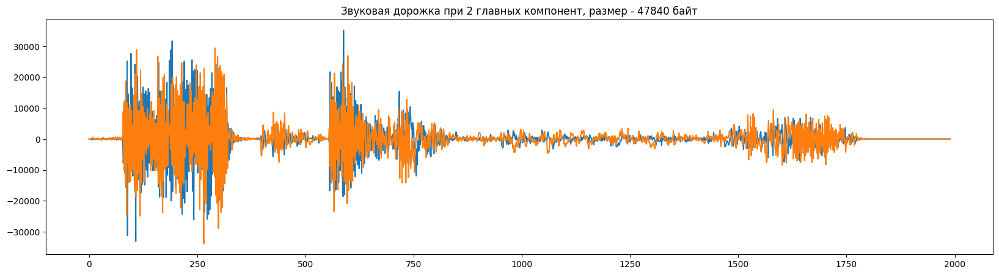

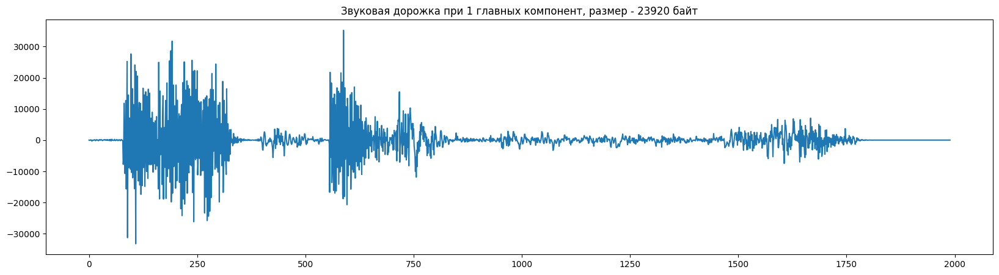

In [ ]:
for n_components in [100, 50, 20, 15, 10, 5, 4, 3, 2, 1]:
  pca = PCA(n_components=n_components)
  plt.figure(figsize=(20,5))
  Y = pca.fit_transform(twodim_sound)
  plt.plot(Y)
  pca_size = Y.nbytes + pca.components_.nbytes
  plt.title(f'Звуковая дорожка при {n_components} главных компонент, размер - {pca_size} байт')
  plt.show()

Изобразил то, как выглядит звуковая дорожка при разном количестве компонент. Видно, что дорожка никогда не прерывается (сомневаюсь, что это полезная информация, но все же привлекло внимание)
А также можно пронаблюдать, в какие моменты частота снижается и повышается - при малом количестве компонент можно заметить промежуток времени, когда частота крайне низкая (от 800 до 1500)

#### 2.3. (4 балла)

Постройте scatter plot датасета в пространстве, задействовав цвет. Сделайте выводы из этого графика. Что вообще изображено?

_Подсказка. Так мы тоже делали на семинаре. Это еще один другой вариант специального применения PCA._

<Figure size 2000x500 with 0 Axes>

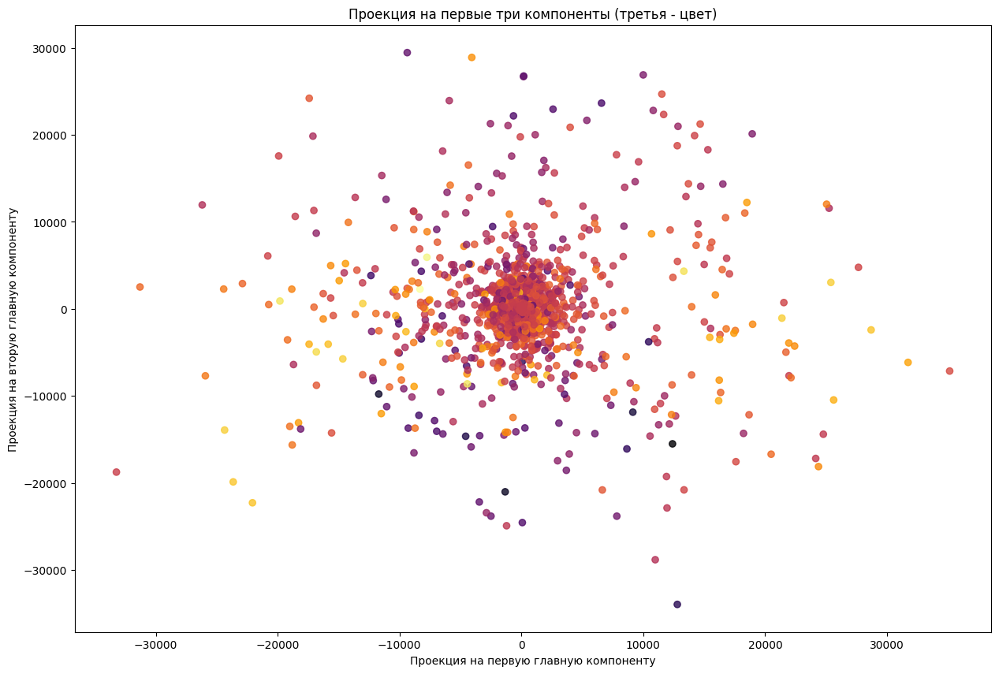

In [ ]:
pca = PCA(n_components=3)
plt.figure(figsize=(20,5))
Y = pca.fit_transform(twodim_sound)

plt.figure(figsize=(15, 10))
plt.scatter(Y[:, 0], Y[:, 1], c=Y[:, 2], alpha=0.8, cmap='inferno')
plt.xlabel('Проекция на первую главную компоненту')
plt.ylabel('Проекция на вторую главную компоненту')
plt.title('Проекция на первые три компоненты (третья - цвет)')
plt.show()

Здесь я отобразил скаттерплот первых трех компонент. На графике видно, что они в основном кучкуются вокруг нуля, что в целом логично, так как они буквально отображают поведение звуковой дорожки, которое и варьируется именно вокруг нуля

### Задание 3

Нам осталось заняться непосредственно "сжатием" звука и проверкой правильности наших действий.

#### 3.1. (4 балла)

Выполните обратное PCA-преобразование сжатых данных и получите "матрицу" со сжатым звуком. Каков будет размер полученной матрицы?

In [ ]:
pca = PCA(n_components=30)
Y = pca.fit_transform(twodim_sound)
pca_sound = pca.inverse_transform(Y)
pca_sound.shape

(1990, 1000)

#### 3.2. (4 балла)

Преобразуйте "матрицу", получившуюся в предыдущем пункте, в сигнал, который можно проиграть (наш "сжатый" монозвук). Воспроизведите результат `(Audio(YOUR_RESULT, rate = samplerate)`.

Похож ли полученный звук на оригинал?

In [ ]:
pca_sound = back_to_arr(pca.inverse_transform(Y))
Audio(pca_sound, rate = samplerate)

#### 3.3. (8 баллов)

Проведите исследование зависимости качества звука от числа компонент.

Подберите "на слух" минимальное число компонент, при котором звук практически не отличается от оригинала.

Добавьте в ячейки два варианта звуковой дорожки: оригинальную и выбранную вами. Укажите, какое число компонент вы оставили.

_Подсказка. Попробуйте отфильтровать сигнал с помощью функции `gaussian_filter1d` из `scipy.ndimage`. Это поможет убрать неприятный дробовой шум при сильном сжатии. Вы поймете, о чем идет речь, когда попробуете это на практике._

_Пример кода для фильтрации: `Audio(gaussian_filter1d(mono_sound_compressed, 2), rate = samplerate)`_

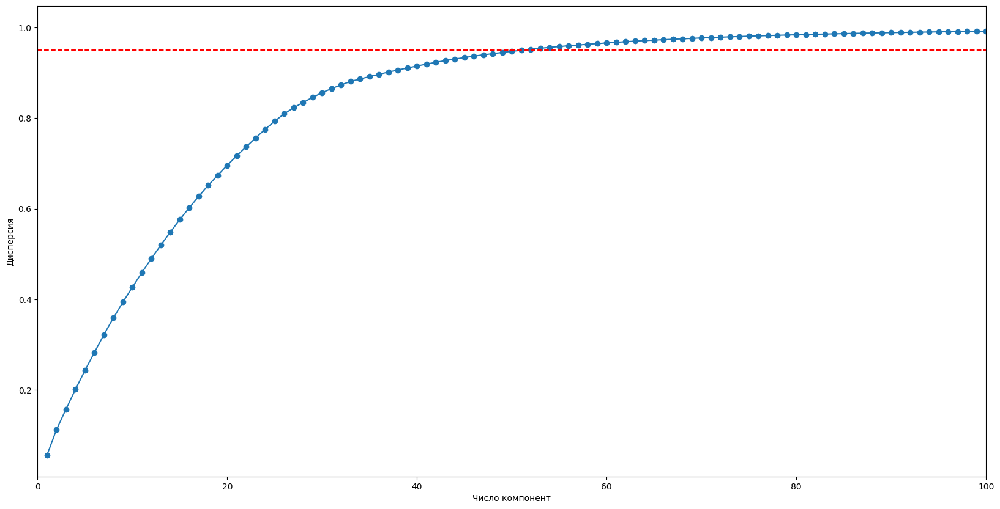

In [ ]:
pca_test = PCA(n_components=None)
pca_test.fit(twodim_sound)

explained_variance_ratio = np.cumsum(pca_test.explained_variance_ratio_)

plt.figure(figsize=(20, 10))
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio, marker='o')
plt.axhline(y=0.95, color='r', linestyle='--')
plt.xlabel('Число компонент')
plt.ylabel('Дисперсия')
plt.xlim(0, 100)
plt.show()

In [ ]:
from scipy.ndimage import gaussian_filter1d

In [ ]:
def audio_components(n_components):
  pca = PCA(n_components=n_components)
  M = pca.fit_transform(twodim_sound)
  pca_sound = pca.inverse_transform(M)
  pca_sound = back_to_arr(pca.inverse_transform(M))
  return Audio(pca_sound, rate = samplerate)

In [ ]:
print(f'Сжатая дорожка')
audio_components(230)

Сжатая дорожка


    Я оставил 230 компонент - при таком количестве, как мне показалось, звук практически не отличается.
    А также я решил не применять "gaussian_filter1d" - как мне показалось, этот параметр сильно ухудшает звук. Даже если выбрать 1000/1000 компонент, качество звука сильно хуже. Однако если его применить, то на малом количестве выбранных компонент он работает отлично

#### 3.4. (6 баллов)
Аргументированно ответьте на следующие вопросы:
- Количество компонент, которое вы выбрали, это много или мало? Как это можно понять?
- Как сильно можно сжать звук таким образом? Какая оптимизация по памяти у вас получилась в ходе проделанной работы?
- Если нам дадут другую звуковую дорожку, нам нужно будет проделать всё то же самое, чтобы сжать звук. Как автоматически подобрать число компонент и возможно ли это?




    1. Я думаю, что я оставил довольно большое количество компонент, так как мне необходимо было сделать так, чтобы звуковая дорожка на слух практически не отличалась от оригинальной. При этом я не воспользовался рекомендацией применить параметр, который убирает шум. Однако при его применении звук перестает меняться уже на 70-80 компонентах. Помимо этого, я решил посмотреть, при каком количестве компонент охватывается 95% дисперсии - график показал, что при 50 компонентах достигается такой результат, а после 90 линия выпрямляется. Все вышеописанное говорит о том, что 230 компонент - это много.



In [ ]:
pca_size = PCA(n_components=230)
M = pca_size.fit_transform(twodim_sound)
print(f'Размер - {M.nbytes + pca_size.components_.nbytes} байт при 230 компонент')

Размер - 5501600 байт при 230 компонент


    2. Выше есть серия графиков, у которых в title пропсиан размер пр определенном количестве компонент. Максимум можно сжать файл до 23920 байт. При выбранных мною 230 компонентах сжатый файл весит 5501600 байт - это значит, что получилось сократить размер на 65% - т.е. уменьшить в три раза.


    3. Судя по тому, что график выше, который отражает охват дисперсии, оказался не совсем применим к аудиодорожке, сложно сказать, как именно можно автоматизировать этот процесс. Возможно есть другие статистические методы, которые позволяют проделать подобное и подобрать необходимое количество компонент. Также стоит учитывать первый шаг - количество делений матрицы, он тоже может влиять на конечный результат. Можно провести некоторое исследование, которое позволит понять, возможно ли автоматизировать процесс - скорее всего при разных входных параметрах и при разных аудифайлах найдется паттерн, который можно применить ко всем аудифайлам



### Задание 4

#### Дополнительное исследование. (15 баллов)
  
  - Оберните получившийся код по сжатию звука в одну или несколько функций.

  - Проведите исследование того, как степень сжатия — соотношение размера частей, на которые делился сигнал в задании 1.1, и размера пространсва, в которое вы сжимали данные с помощью PCA — влияет на звук, по субъективным ощущениям. Начиная с какой степени сжатия сильно заметна потеря качества аудиодорожки? (Как с учетом фильтрации с помощью `gaussian_filter1d`, так и без неё).

  - Что степень сжатия означает для PCA? Для большой аудиозаписи (3 мин, например) мы хотели бы разбить на большее, меньшее или такое же число отрезков как и для предложенной аудиозаписи? Почему?

  - Можно ли как-то автоматически подобрать степерь сжатия? За что она отвечает в нашей задаче? Как степень сжатия влияет на звук? Почему она так влияет на звук?



In [ ]:
mono_sound_to_cut.shape

(1990000,)

In [ ]:
def cut_to_piece(data, divider):
  return data.reshape(int(data.shape[0] / divider), divider)

def back_to_arr(data, divider):
  return data.reshape(data.shape[0] * divider,)

def audio_components(data, n_components, divider):
  pca = PCA(n_components=n_components)
  Y = pca.fit_transform(data)
  pca_sound = pca.inverse_transform(Y)
  pca_sound = back_to_arr(pca.inverse_transform(Y), divider)
  print(Y.nbytes + pca.components_.nbytes)
  return Audio(pca_sound, rate = samplerate)

def sound_pca(data, divider, n_components):
  data = cut_to_piece(data, divider)
  return  audio_components(data, n_components, divider)

Исследование по степени сжатия:
Выяснил, что если изначально разделить дорожку на большее количество частей, а потом взять от нее фиксированную долю компонент (например, 10%), тогда звук будет лучше

Итог - если взять фиксированное количество компонент (например, 50), то наиболее приближенным к оригиналу будет тот, который изначально разделялся на меньшее количество частей

Если сравнивать два подхода, которые описал выше, можно взять две дорожки ниже:

sound_pca(mono_sound_to_cut, 2000, 200)

sound_pca(mono_sound_to_cut, 250, 50)

Первая дорожка звучит лучше, однако если расчитать вес файла, тогда он будет pfvtnyj больше, чем вес второй дорожки. При этом во второй дорожке взято 20% первых компонент. Соответственно появляется теория: чем больше составных частей, тем лучше качество звука при фиксированной доле компонент, однако одновременно с этим сильно увеличивается вес файла

Нужно найти баланс, при котором составных частей меньше, но качество звука не изменяется. Попробую сначала отталкиваться от фиксированной доли компонент, возьму 20%

sound_pca(mono_sound_to_cut, 2000, 400) - это уже слишком много составных частей и компонент, но так и не добился нужного результата - все дорожки звучат заметно хуже оригинала

Когда я отталкивался от 1000 составных частей, выбрал 230 компонент в качестве хорошего варианта.
Если сейчас попробовать взять за основу долю компонент - 23%, тогда звук с каждым разом будет ухудшаться. В таком случае при уменьшении количества частей нужно попробовать увеличивать долю компонент

In [ ]:
sound_pca(mono_sound_to_cut, 250, 75)

4926000


На этом хочу остановиться. после (250, 75) уменьшать количество частей не стоит

А также хочу объясниться касательно "gaussian_filter1d" - этот параметр делает качество звука сильно хуже, из-за чего я никак не могу сравнивать его с оригинальной дорожкой. Может дело в том, что я музыкант?)

Однако я уверен, что даже фанат старых записей Егора Летова сможет услышать крайне сильную разницу

"Что степень сжатия означает для PCA?"

Как я понял, если разбивать данные на большее количество частей, то при применении PCA информация охватывается более качественно, так как каждая составная часть в силу того, что в ней меньше информации, лучше адаптируется к структуре самих данных. Именно поэтому долю компонент можно уменьшать при увеличении количества составных частей

Я думаю, что для большой аудиозаписи стоит разделять данные на меньшее количество составных частей, потому что в таком случае нас будет сильнее интересовать именно уменьшение размера записи

Как мне кажется, на последний вопрос я ответил выше, осталась только рефлексия по автоматизации:

Я думаю, что можно заранее подобрать определенные параметры для записей разной длины - для этого нужно провести большое исследование, после чего уже вывести какую-либо зависимость и реализовать ее в коде

А еще можно применить машинное обучение)
Создать определенное количество размеченных данных (что скорее всего очень сложно) и обучить модель, которая позволяет эффективно сжимать аудиофайлы без явной потери качества звука